In [1]:
%qtconsole

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import imread

In [3]:
D = {'fc7':[], 'prob':[], 'label':[], 'uid':[] }

for i in range(4,6):
    f = '../../data/models/out/obj_test{}.npy'.format(i)
    d = np.load(f).item()
    for k in d:
        D[k] += d[k]
    del d

In [4]:
D['fc7']   = np.concatenate(D['fc7'],   axis=0)
D['prob']  = np.concatenate(D['prob'],  axis=0)
D['label'] = np.concatenate(D['label'], axis=0)
D['uid']   = [it for subl in D['uid'] for it in subl]

In [5]:
label_dict = np.load('../../data/vg_short/label_dict.npy').item()
I = { 'obj': { i:k for k,i in label_dict['obj'].items() },
      'rel': { i:k for k,i in label_dict['rel'].items() } }

In [6]:
M = D['prob'].argmax(axis=1)
P = np.take(D['label'], M)

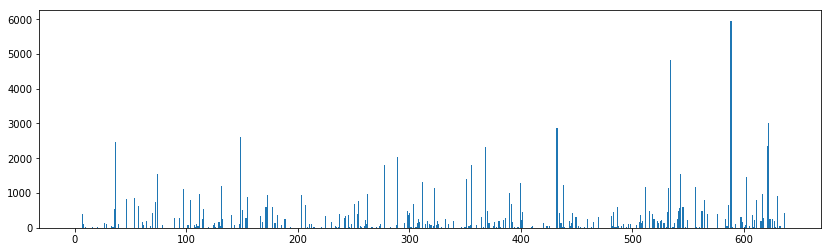

In [7]:
plt.rcParams['figure.figsize'] = (14,4)
n, bins, _ = plt.hist(M, range=(0,637), bins=637); plt.show()

In [78]:
labs = [I['obj'][b - 1] for b in bins if (b>0)]
top_preds = sorted(zip(n, labs), reverse=True)

top_preds[:10]

[(8934.0, 'man.n.01'),
 (7260.0, 'window.n.01'),
 (4503.0, 'tree.n.01'),
 (4296.0, 'building.n.01'),
 (3930.0, 'shirt.n.01'),
 (3684.0, 'water.n.01'),
 (3519.0, 'person.n.01'),
 (3507.0, 'sign.n.02'),
 (3048.0, 'woman.n.01'),
 (2718.0, 'wall.n.01')]

In [11]:
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode()

# confusion 1: outer prod. w/ predictions

In [143]:
N = D['prob'] / D['prob'].sum(axis=0)
confusion = N.T.dot(N)
confusion = confusion * (np.ones_like(confusion) - np.eye(637))

In [183]:
labels = zip(*sorted(I['obj'].items()))[1]

layout = go.Layout(
    autosize=False,
    width=700,
    height=700,
)

data = [
    go.Heatmap(x=labels, 
               y=labels, 
               z=np.power(confusion, 0.25), 
               colorscale='Greys')
]

fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='confuse_matrix')

# confusion 2: GT vs. all predictions

In [8]:
# for each GT label, collect the distribution of predictions
# x: GT, y: predictions
confusion = np.zeros((637, 637))
G = D['label'].argmax(axis=1)

for g in G:
    confusion[g,:] += D['prob'][g,:]

In [9]:
# Normalize over each GT, so `\sum_P(pred | GT) = 1`
# z = np.tile(confusion.sum(axis=1), [637, 1])
confusion = confusion / confusion.sum(axis=1)[...,None]
confusion = np.nan_to_num(confusion)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:3: RuntimeWarning: invalid value encountered in divide
  app.launch_new_instance()


In [13]:
confuse = np.power(confusion, .25)
labels = zip(*sorted(I['obj'].items()))[1]

layout = go.Layout(
    autosize=False,
    width=700,
    height=700,
)

data = [
    go.Heatmap(x=labels, 
               y=labels, 
               z=confuse, 
               colorscale='Greys')
]

fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='confuse_matrix')

<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>

# scrap

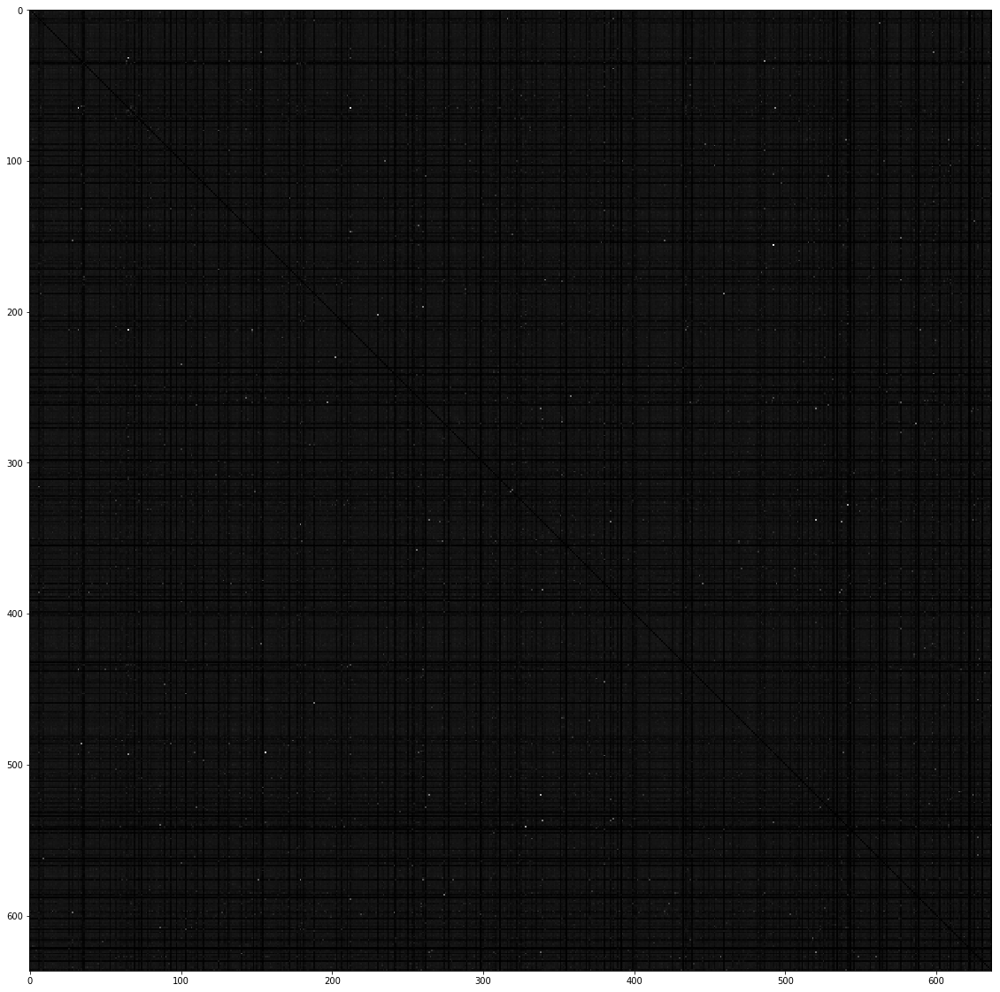

In [145]:
plt.rcParams['figure.figsize'] = (20,20)
plt.imshow(np.power(confusion, 0.8), cmap='gray'); plt.show()

In [162]:
plotly.tools.set_credentials_file(username='ebigelow', api_key='y6y90v7o1e')

In [ ]:
#TODO: list top predictions by GT label
#TODO: top @ k recall

#TODO: bigger picture: 
# - look what happens if we trim down the data a lot (stratified sampling, etc.)
# - maybe trim down more objects -- less than 637 labels